# Hamiltonian Monte-Carlo with Solution

The **Hamiltonian Monte-Carlo (HMC)** algorithm is a type of Markov Chain Monte-Carlo (MCMC) method for obtaining a sequence of random samples that converge to a target distribution for which direct sampling is difficult. HMC is an instance of the Metropolis Hasting algorithm with a proposal inspired by principles from physics. Specifically, at each step a new point is proposed according to a **Hamiltonian dynamics** simulated with a numerical integrator. 

HMC is known to perform better than the random walk Metropolis Hasting or MALA, as consecutive points generated by HMC exhibit lower correlation. This property results in the need for fewer Markov chain samples to effectively approximate the target distribution ("the method mix well").

In this notebook we will focus on a 2-dimensional target distributions as we want to be able to illustrate how the algorithm works.

In [1]:
import numpy as np
import scipy.stats as stat 
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
from functools import partial

from Target import *
from Animation_HMC import *

In [ ]:
""" github_url = 'https://raw.githubusercontent.com/ValentinKil/MCMC/main/Target.py'
Target = requests.get(github_url).text
exec(Target)
github_url = 'https://raw.githubusercontent.com/ValentinKil/MCMC/main/Animation_HMC.py'
Animation_MH = requests.get(github_url).text
exec(Animation_MH) """

## Target Distributions 

Here we will also focus on the two relatively simple target distributions that can be find in **Target.py**. A Gaussian mixture whose modes are not too far apart **gausmix** and a ring-shaped distribution **ring**. 

### Gaussian mixture

For the mixture of Gaussian, we chose to sum 3 Gaussian distribution of dimension 2. The probability density at a point $x$ is given by:

$$
\pi(x) = \frac{1}{3} \left[ 
\mathcal{N}(x | \mu_1, \Sigma_1) + 
\mathcal{N}(x | \mu_2, \Sigma_2) + 
\mathcal{N}(x | \mu_3, \Sigma_3) 
\right]
$$

where $\mathcal{N}(x | \mu_i, \Sigma_i)$ represents the probability density function of a Gaussian distribution with mean $\mu_i$ and covariance matrix $\Sigma_i$ for the $i$^{th} component of the mixture with : 

$$
\mu_1 = \begin{pmatrix} 0 \\ 0 \end{pmatrix};~~~~~\mu_2 = \begin{pmatrix} 1 \\ 1 \end{pmatrix};~~~~~\mu_3 = \begin{pmatrix} 3 \\ 2 \end{pmatrix}
$$

and : 

$$
\Sigma_1 = \Sigma_3 =\begin{pmatrix} 1 & 0 \\ 0 & 1 \end{pmatrix};~~~~~\Sigma_2 = \begin{pmatrix} 2 & 0.5 \\ 0.5 & 2 \end{pmatrix}.
$$

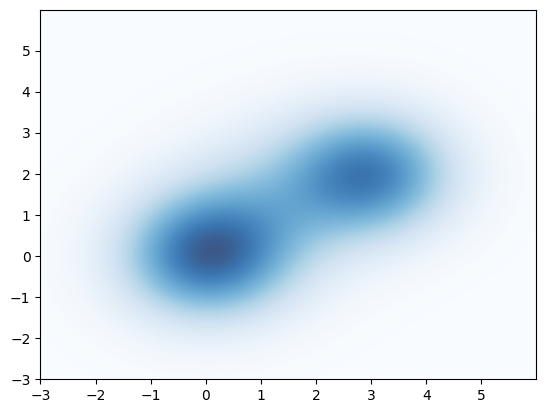

In [2]:
# Plot of the target 
X, Y = np.mgrid[-3:6:.01, -3:6:.01]
pos = np.dstack((X, Y))
fig2 = plt.figure()
ax2 = fig2.add_subplot(111)
ax2.pcolormesh(X, Y, gausmix(pos),cmap='Blues',alpha=0.8)
plt.show()

### Ring-shaped distribution

The second target distribution we will focus on is a ring-shaped distribution. This distribution mimics, in 2 dimensions, the behaviour of a simple Gaussian in very high dimension, indeed, in high dimension, the mass of a Gaussian concentrated in a ring, called the typical set. The probability density at a point $x$ is given by:

$$
\pi(x)= \exp\left(-\frac{1}{2} \left(\sqrt{x_1^2 + x_2^2} - 3\right)^2\right),
$$

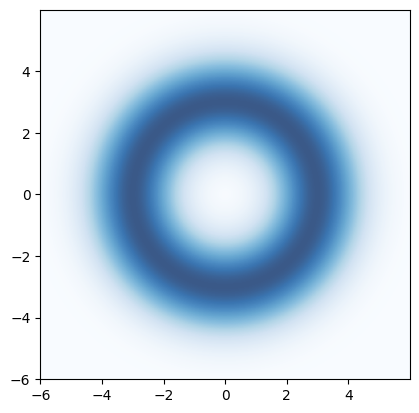

In [3]:
# Plot of the ring target 
X, Y = np.mgrid[-6:6:.01, -6:6:.01]
pos = np.dstack((X, Y))
fig2 = plt.figure()
ax2 = fig2.add_subplot(111)
ax2.pcolormesh(X, Y, ring(pos),cmap='Blues',alpha=0.8)
plt.axis('square') 
plt.show()

## HMC Sampler

We now want to implement a HMC Sampler using the algorithm explained in the lecture note. To use the animation functions provided below, the algorithm should return two np.array :

* **sample** of size (n_iter,3), where n_iter is the number of samples we want to get. For each $i\in[[ 1,n\_iter]]$, we should let **sample[i,0:2]** be the new state proposed by the proposal distribution, and **sample[i,2]** should be True if the new state is accepted and False otherwise.

* **Trajectories** of size (n_iter,L,2), where L is the number of leapfrog steps. For each $i\in[[ 1,n\_iter]]$, we should let **Trajectories[i]** contain the successive positions of the leap-frog steps. To display the trajectories.  

 The function should be general enough to accept any distribution target and any proposal/update rule.

In [4]:
def Leapfrog(curr_pos,curr_momentum,delta_U,M,epsilon=1e-1,L=100):
    dim=curr_pos.shape[0]
    trajectory=np.zeros(shape=(L,dim))
    trajectory[0]=curr_pos
    for i in range(1,L):
        curr_momentum-=epsilon/2*delta_U(curr_pos)
        curr_pos+=epsilon*np.matmul(np.linalg.inv(M),curr_momentum)
        curr_momentum-=epsilon/2*delta_U(curr_pos)
        trajectory[i]=curr_pos
    return trajectory,curr_momentum

def Hamiltonian(pos,momentum,M,U):
    kinetic=1/2*np.matmul(momentum,np.matmul(M,np.transpose(momentum)))
    potential=U(pos)
    return kinetic+potential

def HMC_updater(curr_pos,U,delta_U,M,epsilon=1e-1,L=100):
    #Resample the momentum
    curr_momentum=stat.multivariate_normal.rvs(mean=np.zeros_like(curr_pos),cov=M)
    #Propose a new position with L Leapfrog update
    trajectory,new_momentum=Leapfrog(curr_pos,curr_momentum,delta_U,M,epsilon,L)
    new_pos=trajectory[-1]
    # Compute the acceptance probability
    ratio=np.exp(Hamiltonian(curr_pos,curr_momentum,M,U)-Hamiltonian(new_pos,new_momentum,M,U))
    alpha=min(1,ratio)
    U=np.random.uniform(0,1)
    if U<alpha:
        return trajectory,True
    else:
        return trajectory,False
    
def HMC_sampler(U,delta_U,M,init_pos,n_iter,epsilon=1e-1,L=100):
    """Run the HMC algorithm for n_iter iterations."""
    # Initialize the state
    curr_pos=init_pos
    dim=np.shape(init_pos)[0]
    sample=np.zeros(shape=(n_iter,dim+1))
    sample[0,0:dim]=curr_pos
    sample[0,dim]=True
    Trajectories=np.zeros(shape=(n_iter,L,dim))
    i=1
    while i<n_iter:
        # Update the state
        trajectory,accept=HMC_updater(curr_pos,U,delta_U,M,epsilon,L)
        new_pos=trajectory[-1]
        Trajectories[i]=trajectory
        sample[i,0:dim]=new_pos
        sample[i,dim]=accept
        i+=1
        if accept:
            curr_pos=new_pos
        if not accept:
            sample[i,0:dim]=curr_pos
            sample[i,dim]=True
            Trajectories[i]=np.zeros(shape=(L,dim))
            i+=1
    return sample,Trajectories
    

### Plot of the Markov Chain

We want to display the MCMC method nicely, the functions can be find in **Animation_HMC.py**, they takes some time and probably deserve some improvement but gives good animations. 

## Gaussian mixture

Let us start by displaying the method for our Gaussian mixture distribution.

In [5]:
#Choose parameters 
M=np.array([[1,0.],[0.,1]]) #Mass Matrix
epsilon=1e-1
L=50
n_iter=200
init_pos=np.array([0.,0.])

#Sampling

sample,Trajectories=HMC_sampler(Ugaussmix,delta_Ugaussmix,M,init_pos=init_pos,n_iter=n_iter,epsilon=epsilon,L=L)

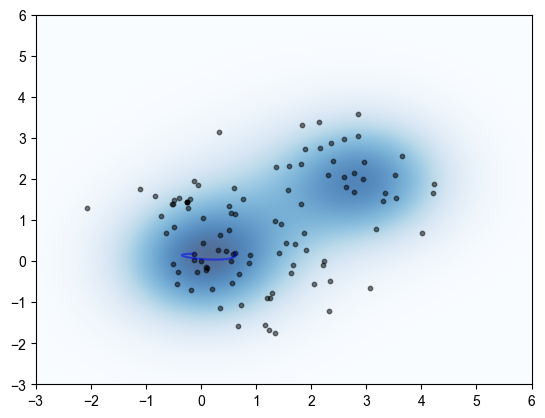

In [6]:
# Animation

xmin,xmax=-3,6
ymin,ymax=-3,6

fig, ax = plt.subplots()

background_plot(ax, target=gausmix, xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax)  # Add the background figure

particle = ax.scatter([], [], c='black', s=10, marker='o', alpha=1)  # Initial position with higher alpha
trail = ax.scatter([], [], c='black', s=10, marker='o', alpha=0.5)  # Particle trail with lower alpha
line, = ax.plot([], [], c='black', alpha=0.5)  # Line for trajectories

partial_init=partial(init,xmin=xmin,xmax=xmax,ymin=ymin,ymax=ymax,particle=particle,trail=trail,ax=ax,square=False)

# Create the animation
partial_update= partial(update,sample=sample,particle=particle,Trajectories=Trajectories,line=line,trail=trail)
ani = FuncAnimation(fig, partial_update, frames=100, init_func=partial_init, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())


In [11]:
n_iter=2000
sample1,traj1 = HMC_sampler(Ugaussmix,delta_Ugaussmix,M,init_pos=init_pos,n_iter=n_iter,epsilon=epsilon,L=L)
sample2,traj2 = HMC_sampler(Ugaussmix,delta_Ugaussmix,M,init_pos=init_pos,n_iter=n_iter,epsilon=epsilon,L=L)
sample3,traj3 = HMC_sampler(Ugaussmix,delta_Ugaussmix,M,init_pos=init_pos,n_iter=n_iter,epsilon=epsilon,L=L)

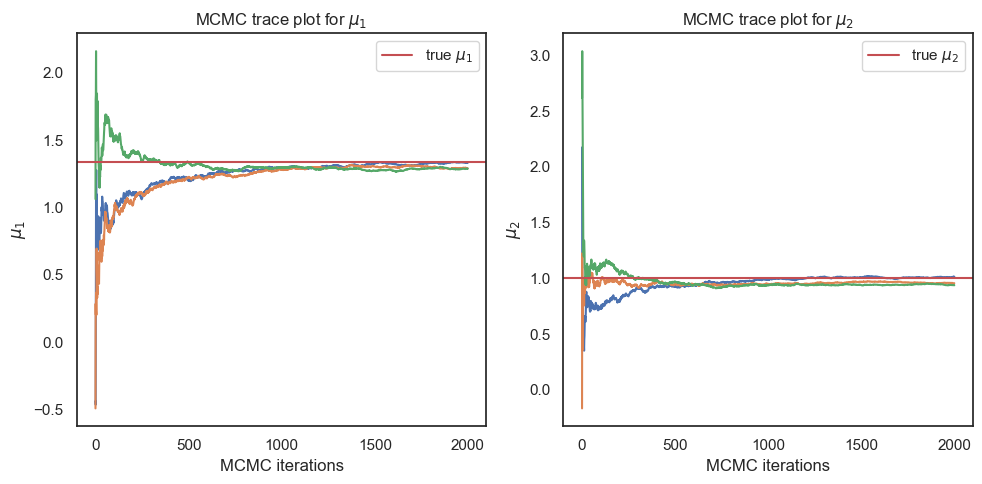

In [12]:
burnin=0

# Compute cumulative averages after burnin
Avgs = [calculate_cumulative_average(sample[burnin:]) for sample in [sample1, sample2, sample3]]

nb_gaussian = len(moy_list)
Truemean = np.cumsum(moy_list, axis=0)[-1] / nb_gaussian

fig, axs = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns setup

for i in range(2):  # Assuming two parameters for simplicity
    for Avg in Avgs:
        axs[i].plot(Avg[:, i])
    axs[i].axhline(Truemean[i], color='r', label=f"true $\\mu_{i+1}$")
    axs[i].set_title(f'MCMC trace plot for $\\mu_{i+1}$')
    axs[i].set_xlabel('MCMC iterations')
    axs[i].set_ylabel(f'$\\mu_{i+1}$')
    axs[i].legend()

plt.tight_layout()
plt.show()
    

## Ring-shaped distribution 

Then for the ring distribution 

In [13]:
#Choose parameters 
M=np.array([[1,0.],[0.,1]]) #Mass Matrix
epsilon=1e-1
L=100
n_iter=200
init_pos=np.array([0.,3.])

sample,Trajectories=HMC_sampler(Uring,delta_Uring,M,init_pos=init_pos,n_iter=n_iter,epsilon=epsilon,L=L)

Animation size has reached 21073014 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


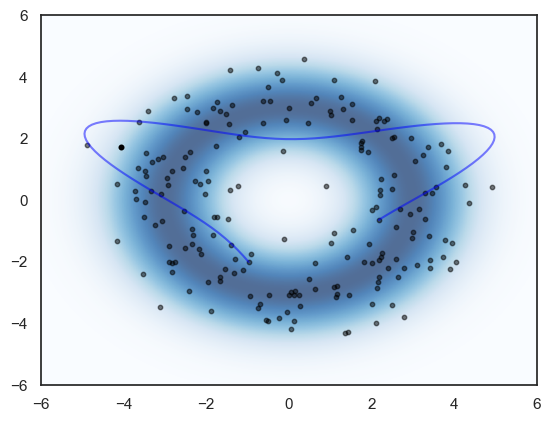

In [14]:
# Animation

xmin=center[0]-2*radius
xmax=center[0]+2*radius
ymin=center[1]-2*radius
ymax=center[1]+2*radius

fig, ax = plt.subplots()

background_plot(ax, target=ring, xmin=xmin, xmax=xmax, ymin=ymin, ymax=ymax)  # Add the background figure

particle = ax.scatter([], [], c='black', s=10, marker='o', alpha=1)  # Initial position with higher alpha
trail = ax.scatter([], [], c='black', s=10, marker='o', alpha=0.5)  # Particle trail with lower alpha
line, = ax.plot([], [], c='black', alpha=0.5)  # Line for trajectories

partial_init=partial(init,xmin=xmin,xmax=xmax,ymin=ymin,ymax=ymax,particle=particle,trail=trail,ax=ax,square=True)

# Create the animation
partial_update= partial(update,sample=sample,particle=particle,Trajectories=Trajectories,line=line,trail=trail)
ani = FuncAnimation(fig, partial_update, frames=200, init_func=partial_init, blit=True)

# Display the animation in the notebook
HTML(ani.to_jshtml())

In [15]:
n_iter=2000
sample1,traj1 = HMC_sampler(Uring,delta_Uring,M,init_pos=init_pos,n_iter=n_iter,epsilon=epsilon,L=L)
sample2,traj2 = HMC_sampler(Uring,delta_Uring,M,init_pos=init_pos,n_iter=n_iter,epsilon=epsilon,L=L)
sample3,traj3 = HMC_sampler(Uring,delta_Uring,M,init_pos=init_pos,n_iter=n_iter,epsilon=epsilon,L=L)

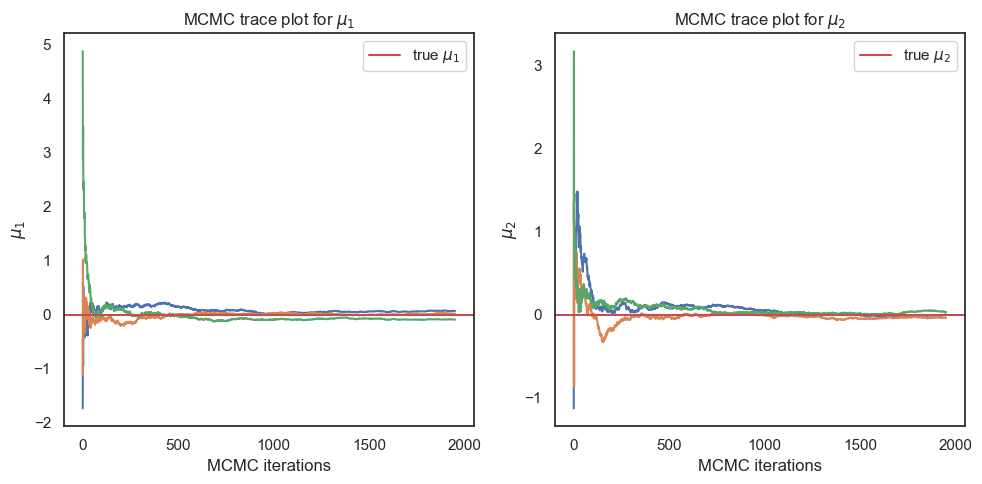

In [17]:
burnin=50

# Compute cumulative averages after burnin
Avgs = [calculate_cumulative_average(sample[burnin:]) for sample in [sample1, sample2, sample3]]

fig, axs = plt.subplots(1, 2, figsize=(10, 5))  # 1 row, 2 columns setup

for i in range(2):  # Assuming two parameters for simplicity
    for Avg in Avgs:
        axs[i].plot(Avg[:, i])
    axs[i].axhline(center[i], color='r', label=f"true $\\mu_{i+1}$")
    axs[i].set_title(f'MCMC trace plot for $\\mu_{i+1}$')
    axs[i].set_xlabel('MCMC iterations')
    axs[i].set_ylabel(f'$\\mu_{i+1}$')
    axs[i].legend()

plt.tight_layout()
plt.show()
    